# Laboratorium 9

Imports

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageOps, ImageDraw, ImageFont, ImageFilter
import cv2

In [3]:
def process_img(img, is_rgb = True): 
    gray_image = img.convert('L')
    inverted_image = ImageOps.invert(gray_image)
    return (gray_image, np.swapaxes(np.array(gray_image), 0, 1)) if is_rgb \
        else (inverted_image, np.swapaxes(np.array(inverted_image), 0, 1))

In [4]:
def image_analysis(image_path, pattern_path, max_col_val = 0.5, is_rgb = True):
    image =  Image.open(image_path)
    image_pattern = Image.open(pattern_path)

    w, h = image.size  

    # process image -> change image to gray cmap
    gray_image, processed_img = process_img(image, is_rgb)
    gray_pattern, processed_pattern = process_img(image_pattern, is_rgb)

    dft_image = np.fft.fft2(processed_img)
    shifted_dft_image = np.fft.fftshift(np.fft.fft2(processed_img))
    
    # plot for result

    fig, ax = plt.subplots(3,2,figsize=(20,20))
    fig.tight_layout()

    ax[0,0].imshow(gray_image, cmap='gray')
    ax[0,0].set_title("Processed image")


    ax[0,1].imshow(gray_pattern, cmap='gray')
    ax[0,1].set_title("Processed pattern")

    ax[1,0].imshow(np.swapaxes(np.log(abs(shifted_dft_image)), 0, 1), cmap='gray')
    ax[1,0].set_title("Fourier Transformation of the Image (amplitude) - shifted")

    ax[1,1].imshow(np.swapaxes(np.angle(shifted_dft_image), 0, 1), cmap='gray')
    ax[1,1].set_title("Phase value - shifted")

      
    C = np.real(np.fft.ifft2(np.multiply(dft_image, np.fft.fft2(np.rot90(processed_pattern, 2), s = (w, h)))))
    max_C = np.amax(C)
    new_image = np.array(Image.open(image_path).convert("RGB"))

    occurences = 0

    for i in range(C.shape[0]):
        for j in range(C.shape[1]):
            if C[i, j] >= max_col_val * max_C:
                new_image[j, i][1] = 200
                occurences += 1
    gs = ax[2, 0].get_gridspec()
    for ax_ in ax[-1, :]:
        ax_.remove()

    axbig = fig.add_subplot(gs[-1, :])
    axbig.imshow(new_image)
    axbig.set_title("Final version - Occurences: {}".format(occurences))

    plt.show()



### Fish

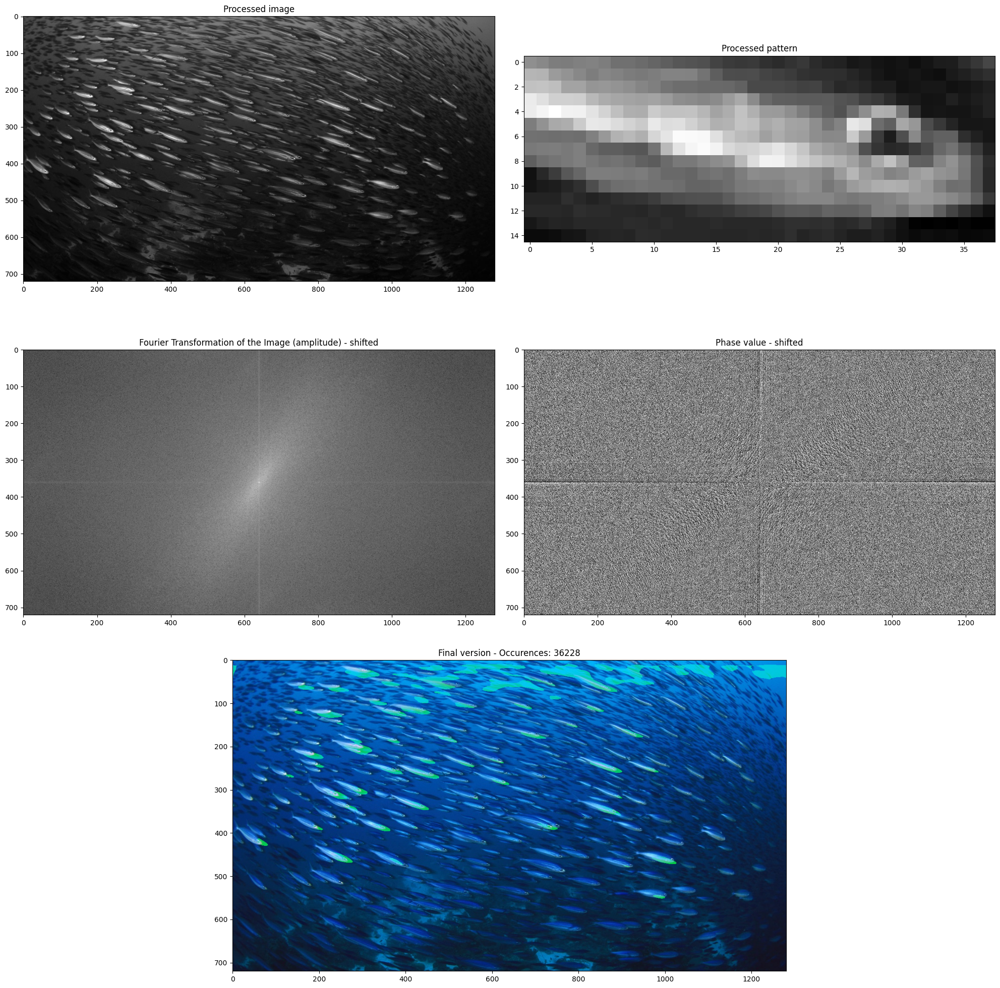

In [41]:
image_analysis("school.jpg", "fish1.png", 0.6)

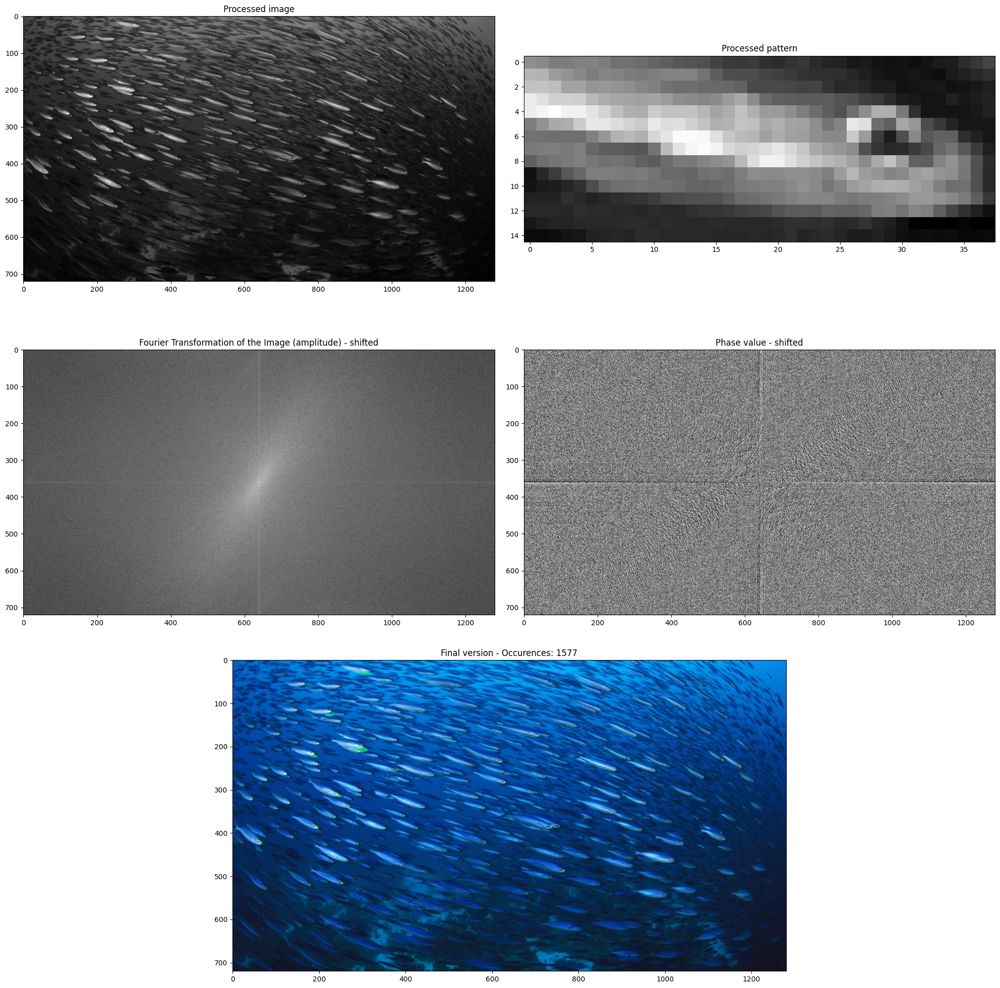

In [48]:
image_analysis("school.jpg", "fish1.png", 0.8)

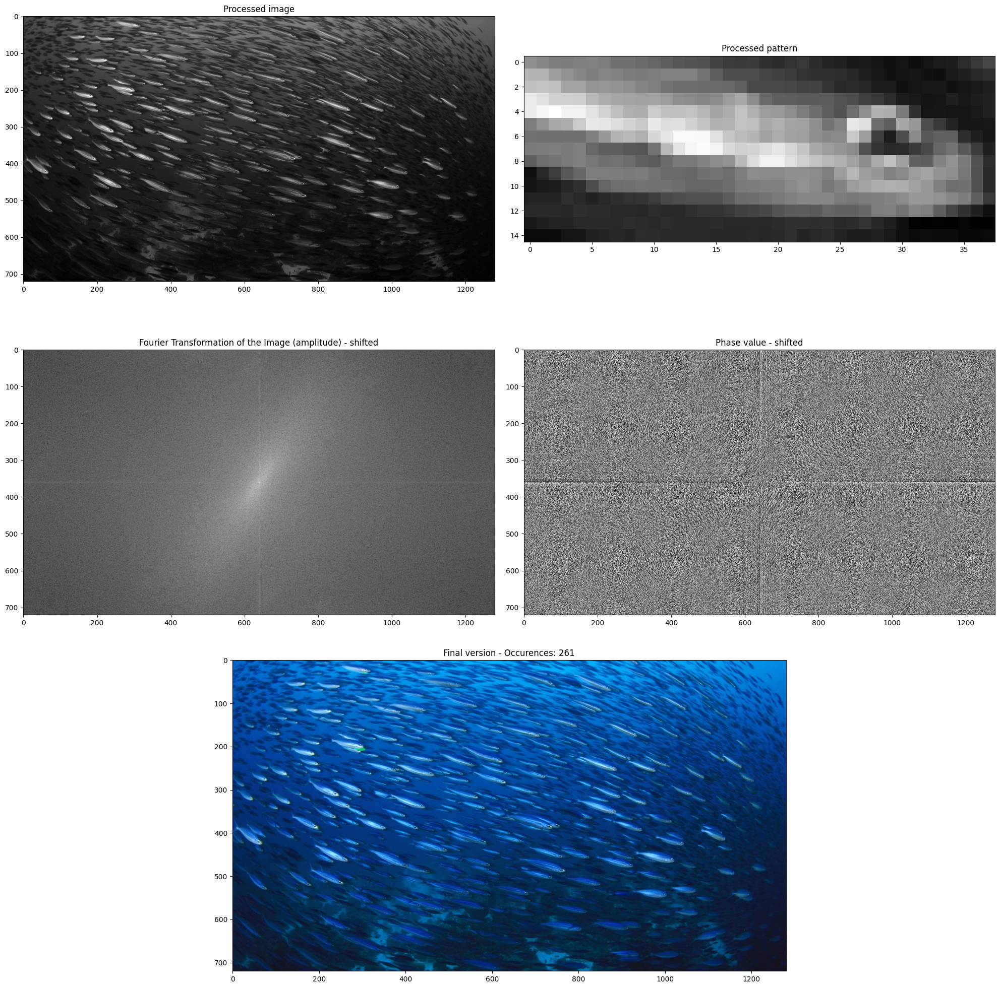

In [49]:
image_analysis("school.jpg", "fish1.png", 0.9)

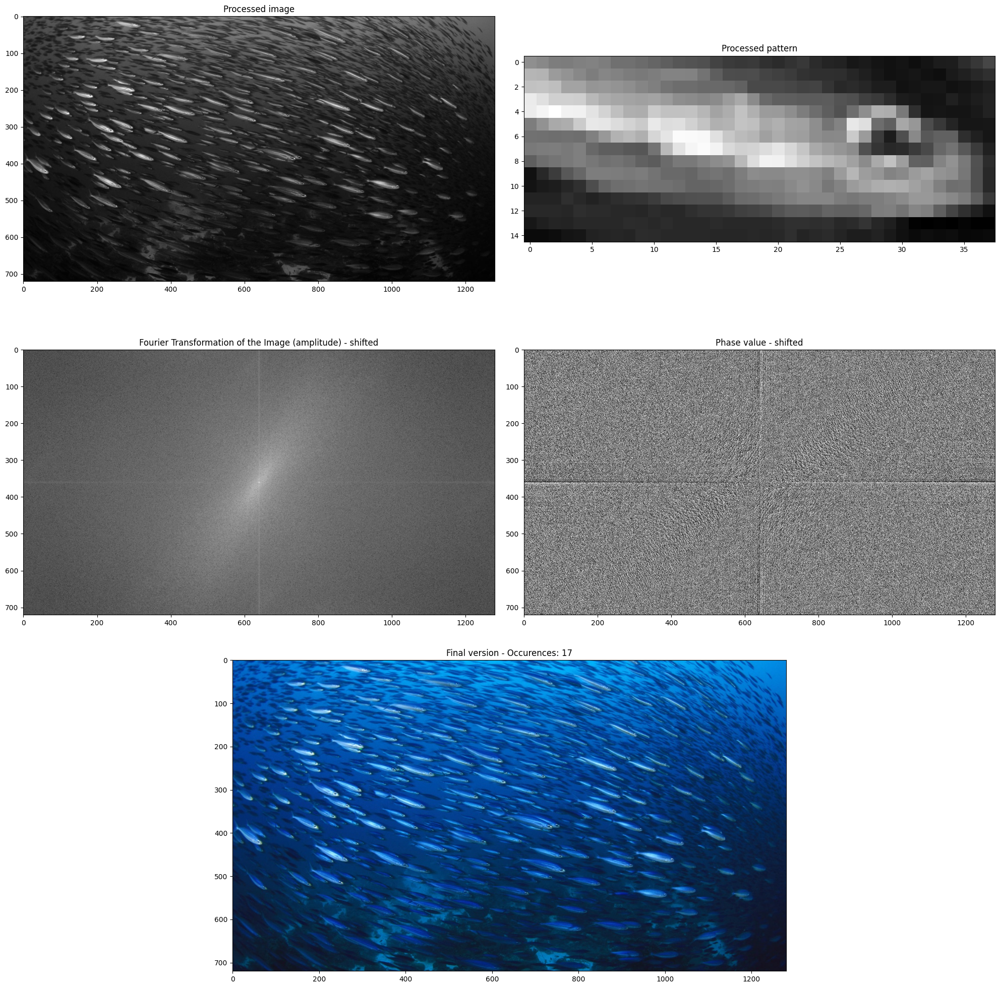

In [50]:
image_analysis("school.jpg", "fish1.png", 0.99)

### Galia

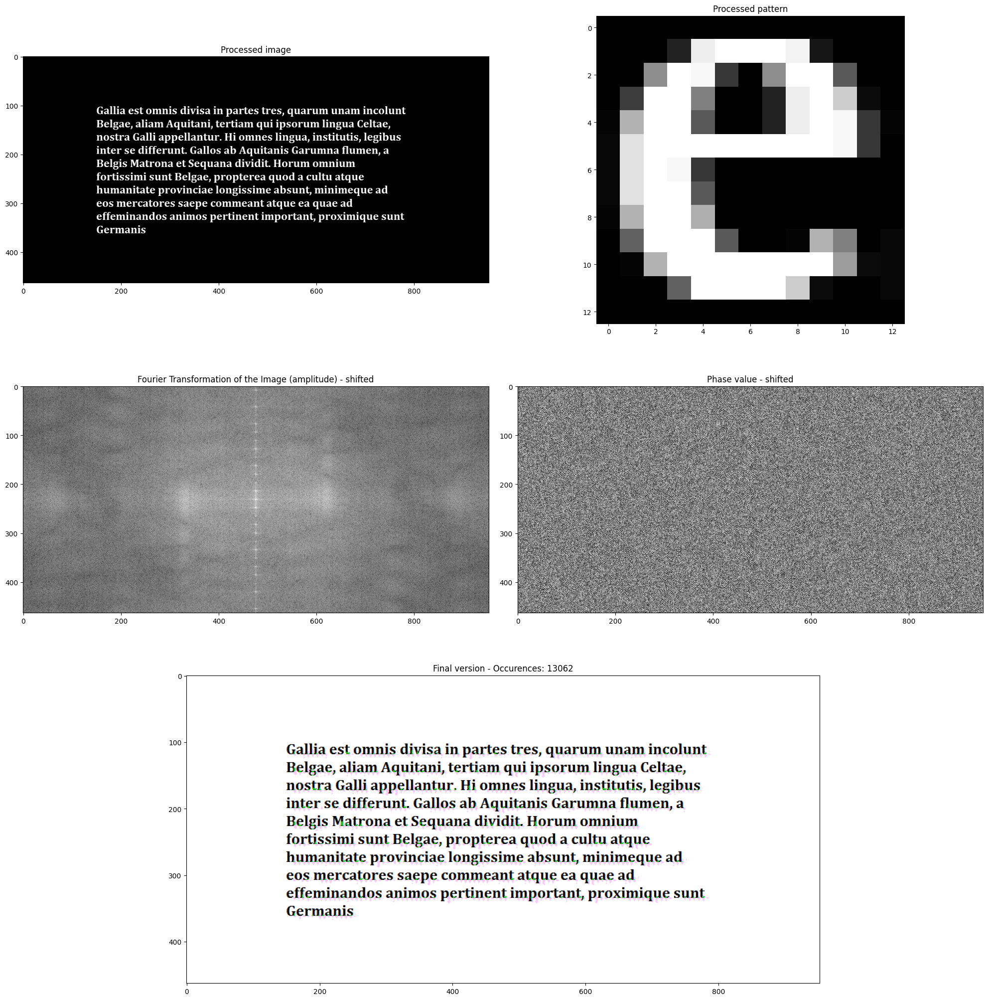

In [43]:
image_analysis("galia.png", "galia_e.png", 0.5, False)

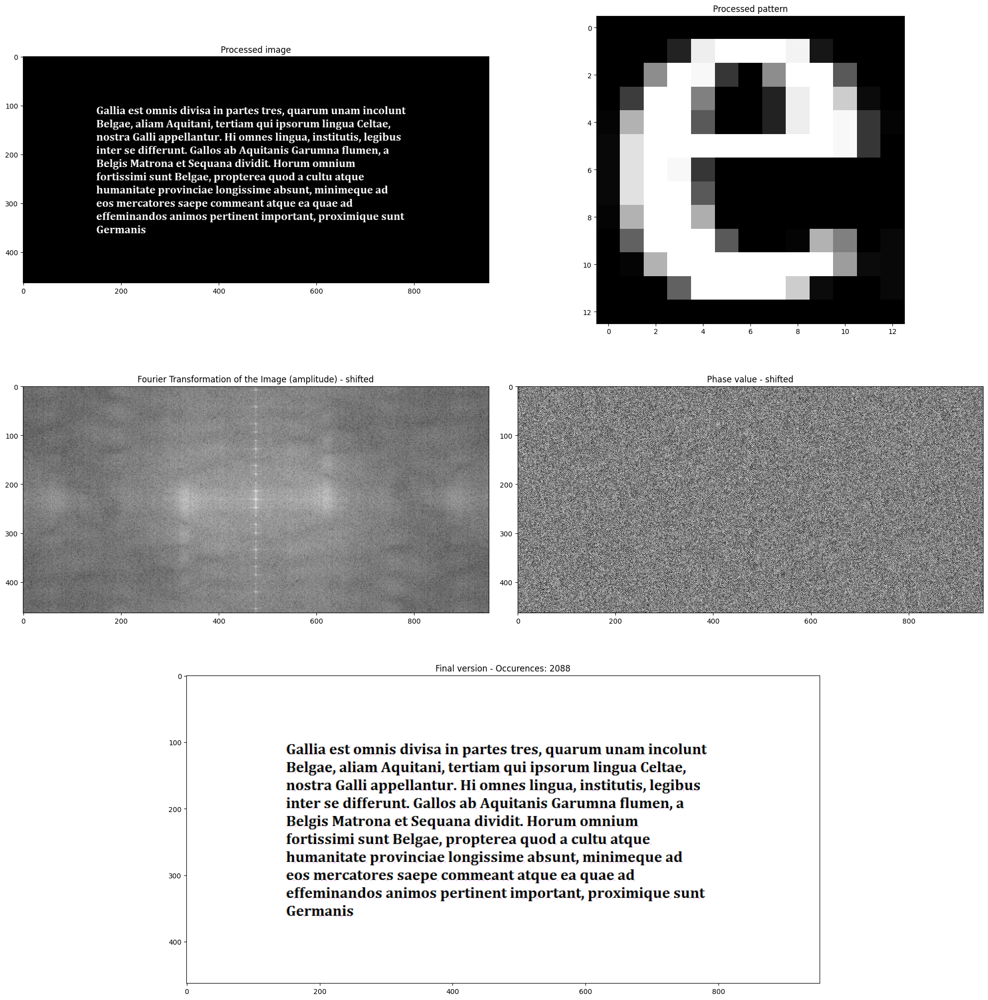

In [42]:
image_analysis("galia.png", "galia_e.png", 0.7, False)

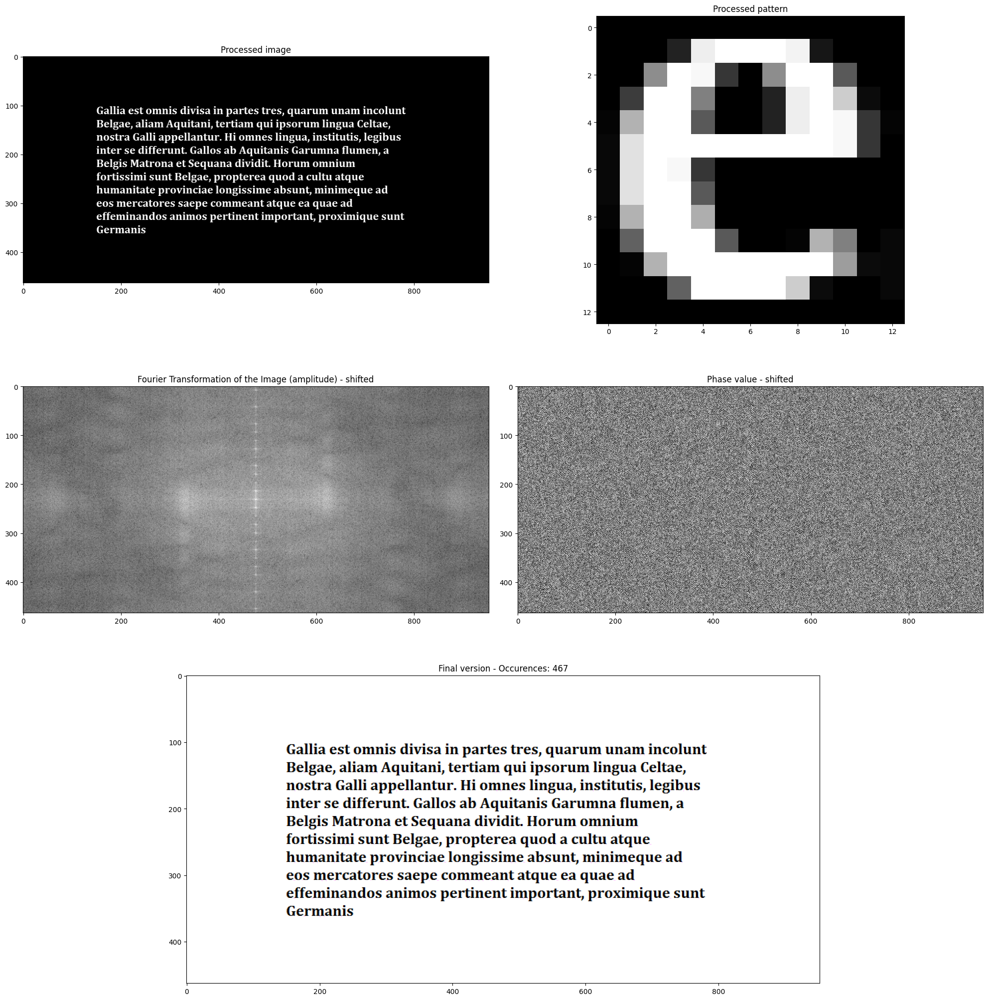

In [47]:
image_analysis("galia.png", "galia_e.png", 0.8, False)

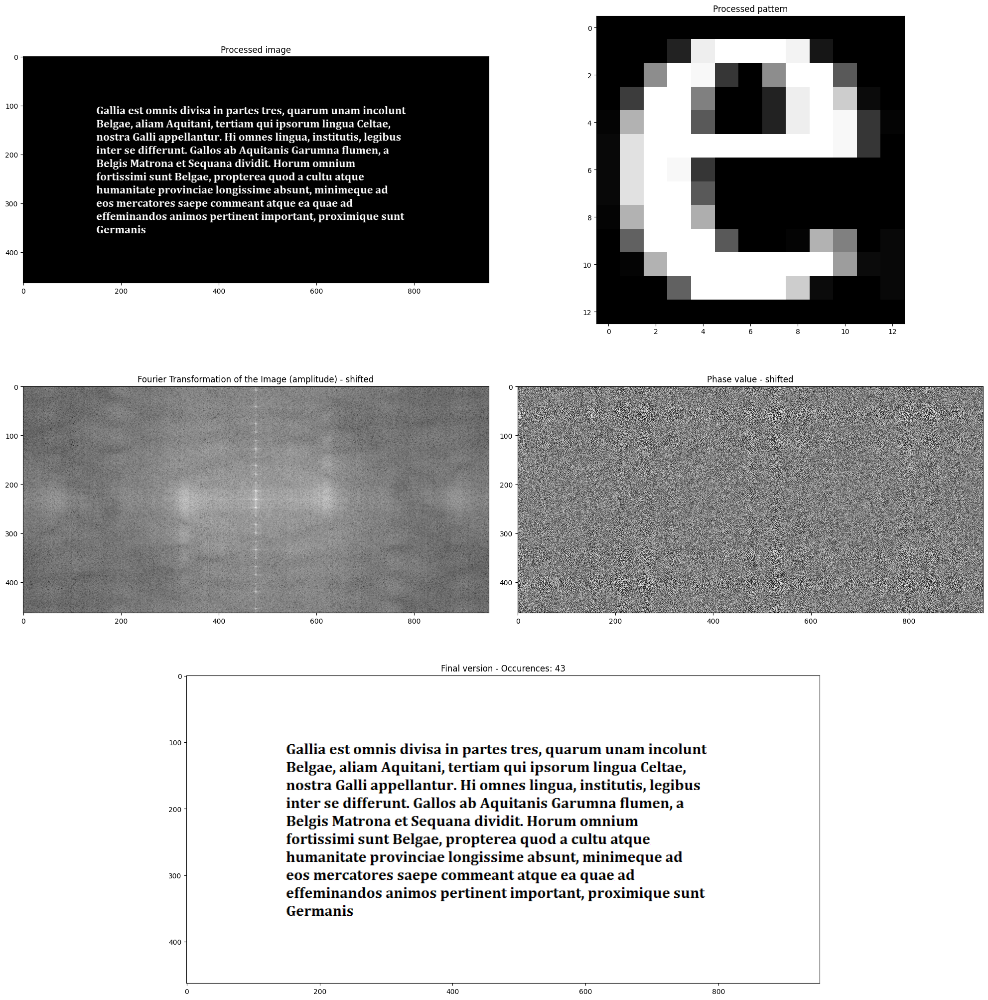

In [209]:
image_analysis("galia.png", "galia_e.png", 0.95, False)

Wnioski:
- dla tekstu i literki "e" algortym zwraca poprwaną liczbę wystąpień

## OCR

In [5]:
def save_img_invert(img, is_rgb = False):
    gray_image = img.convert('L')
    inverted_image = ImageOps.invert(gray_image)
    return (gray_image, np.swapaxes(np.array(gray_image), 0, 1)) if is_rgb \
        else (inverted_image, np.swapaxes(np.array(inverted_image), 0, 1))

In [6]:
def load_characters(character_list, font_file):
    font_size = 28
    char_dict = {}

    for character in character_list:

        font = ImageFont.truetype(font_file, font_size)
        font_width, font_height = font.getsize(character)
        img_w, img_h = font_width, font_height

        im = Image.new("L", (img_w, img_h), color='white')
        draw = ImageDraw.Draw( im )
        draw.text(( (img_w-font_width)/2, (img_h-font_height)/2), character, font=font, fill = 0,  align="center")
        
        np_array = np.array(im)
        char_dict[character] = np_array
    # to debug
    im.save("a.png")
    return char_dict

In [7]:
char_dict = load_characters("abcde", "Arial.ttf")

In [12]:
def prepare(image):
    img = cv2.imread(image)
    textImg = img.copy()

    gray_img = cv2.cvtColor(textImg, cv2.COLOR_BGR2GRAY)

    #Threshhold the image
    _, threshold_image = cv2.threshold(gray_img, 0.0, 255.0, cv2.THRESH_BINARY | cv2.THRESH_OTSU)

    # applaying Sobel edge detection
    edges = cv2.Canny(threshold_image, 50, 150)

    #Hough transform
    lines = cv2.HoughLines(edges, 1, np.pi / 180, 200)

    
    
    # coords = np.column_stack(np.where(bw > 0))
    # print(np.where(bw > 0))
    # angle = cv2.minAreaRect(coords)[-1]
    # print(coords[1, 1])
    cv2.imwrite("starry_night.png", threshold_image)
    ... # aligns and denoises

In [11]:
prepare("short_arial.png")

In [53]:
def format_line(text, output):
    ... # return output -> formats single line to output

In [54]:
def format_text(array):
    ... # format whole text for printing